In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import geopandas

import seaborn as sns

In [2]:
df = pd.read_csv('Dataset 1.csv')

In [3]:
#performing analysis on two different city

bangalore = df[df.city=='Bangalore']
mumbai = df[df.city=='Mumbai']


In [4]:
#df.dropna(subset = ['poi_type'],inplace = True)
#food =df[df['poi_type'].str.contains('food')].head()
bangalore.head()

,source,poi_code,name,poi_type,lat,long,address,city,state,country,pin_code,brand
0,OSM,POI_1003_6612393918,Parle,shop.food.bakery,13.049754,77.492895,NaN,Bangalore,Karnataka,India,NaN,NaN
1,OSM,POI_1003_6613030600,The Black Pearl,food.restaurant,12.939213,77.694701,NaN,Bangalore,Karnataka,India,NaN,NaN
2,OSM,POI_1003_4668296373,Temple,NaN,12.940448,77.693816,NaN,Bangalore,Karnataka,India,NaN,NaN
3,OSM,POI_1003_3771995983,Kadubeesanahalli Underpass,NaN,12.939450,77.695305,NaN,Bangalore,Karnataka,India,NaN,NaN
4,OSM,POI_1003_2413350412,NaN,health.wellbeing.swimming_pool,12.940660,77.693607,NaN,Bangalore,Karnataka,India,NaN,NaN


In [5]:
bangalore.head()

,source,poi_code,name,poi_type,lat,long,address,city,state,country,pin_code,brand
0,OSM,POI_1003_6612393918,Parle,shop.food.bakery,13.049754,77.492895,NaN,Bangalore,Karnataka,India,NaN,NaN
1,OSM,POI_1003_6613030600,The Black Pearl,food.restaurant,12.939213,77.694701,NaN,Bangalore,Karnataka,India,NaN,NaN
2,OSM,POI_1003_4668296373,Temple,NaN,12.940448,77.693816,NaN,Bangalore,Karnataka,India,NaN,NaN
3,OSM,POI_1003_3771995983,Kadubeesanahalli Underpass,NaN,12.939450,77.695305,NaN,Bangalore,Karnataka,India,NaN,NaN
4,OSM,POI_1003_2413350412,NaN,health.wellbeing.swimming_pool,12.940660,77.693607,NaN,Bangalore,Karnataka,India,NaN,NaN


In [6]:
mumbai.head()

,source,poi_code,name,poi_type,lat,long,address,city,state,country,pin_code,brand
12,OSM,POI_1003_6614922840,The Culture House,food.restaurant,18.957073,72.810220,NaN,Mumbai,Maharashtra,India,400007,NaN
13,OSM,POI_1003_4510283089,NaN,NaN,18.957638,72.809923,NaN,Mumbai,Maharashtra,India,NaN,NaN
14,OSM,POI_1003_7664032200,Dolby Hospital,health.hospital.general,18.957096,72.811597,"KM Munshi Road, Gamdevi, Mumbai",Mumbai,Maharashtra,India,400007,NaN
15,OSM,POI_1003_7664032214,Smt. Motiben B. Dalvi Hospital,health.hospital.general,18.958287,72.810282,"N S Patkar Marg, Opp Westside, Babulnath, Dadi...",Mumbai,Maharashtra,India,400007,NaN
16,OSM,POI_1003_3978876100,Hotel Sapna,travel.accommodation.hotel,18.957259,72.810298,NaN,Mumbai,Maharashtra,India,400007,NaN


In [7]:
mumbai.dropna(subset = ['poi_type'],inplace = True)

<ipython-input-7-ddd5e176beb4>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  mumbai.dropna(subset = ['poi_type'],inplace = True)


In [8]:
M_cord = mumbai[['lat','long']]
B_cord = bangalore[['lat','long']]

In [9]:
M_cord.head()

,lat,long
12,18.957073,72.810220
14,18.957096,72.811597
15,18.958287,72.810282
16,18.957259,72.810298
17,18.958225,72.811215


In [10]:
import warnings
warnings.filterwarnings("ignore")

In [11]:
B_cord.head()

,lat,long
0,13.049754,77.492895
1,12.939213,77.694701
2,12.940448,77.693816
3,12.939450,77.695305
4,12.940660,77.693607


In [12]:
from sklearn.cluster import KMeans


#### KMeans Algorithm for Bangalore city

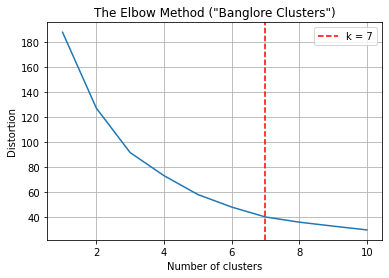

In [13]:
# K - means in a better way

X = bangalore[['lat','long']]
max_k = 10
## iterations
distortions = [] 
for i in range(1, max_k+1):
    if len(X) >= i:
       model = KMeans(n_clusters=i, init='k-means++', max_iter=300, n_init=10, random_state=0)
       model.fit(X)
       distortions.append(model.inertia_)
## best k: the lowest derivative
k = [i*100 for i in np.diff(distortions,2)].index(min([i*100 for i 
     in np.diff(distortions,2)]))
## plot
fig, ax = plt.subplots()
ax.plot(range(1, len(distortions)+1), distortions)
ax.axvline(k, ls='--', color="red", label="k = "+str(k))
ax.set(title='The Elbow Method ("Banglore Clusters")', xlabel='Number of clusters', 
       ylabel="Distortion")
ax.legend()
ax.grid(True)
plt.show()

it can be observed that choice of elbow is pretty ambigious, so we have to try some other approach.

### Silhousett Method (Banglore city)

In [14]:
#importing required library

from sklearn.metrics import silhouette_score

sil = []
kmax = 16

# dissimilarity would not be defined for a single cluster, thus, minimum number of clusters should be 2
for k in range(2, kmax+1):
  kmeans = KMeans(n_clusters = k).fit(B_cord)
  labels = kmeans.labels_
  sil.append(silhouette_score(B_cord, labels, metric = 'euclidean'))

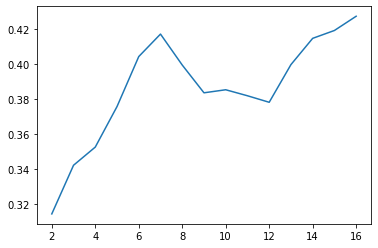

In [15]:
x = np.arange(2,kmax+1)
y = sil

plt.plot(x,y)

At k = 7 we can observe the peak of the silhouset score. we will select number of cluster equals to seven for the bangalore city. 

In [16]:
B_cord.head()

,lat,long
0,13.049754,77.492895
1,12.939213,77.694701
2,12.940448,77.693816
3,12.939450,77.695305
4,12.940660,77.693607


In [17]:
#for bangalore
kmeans = KMeans(7)
kmeans.fit(B_cord)
identified_clusters = kmeans.labels_
B_cord['cluster'] = identified_clusters
bangalore['cluster'] = identified_clusters

Text(0.5, 1.0, 'Clusters representation in Bangalore city')

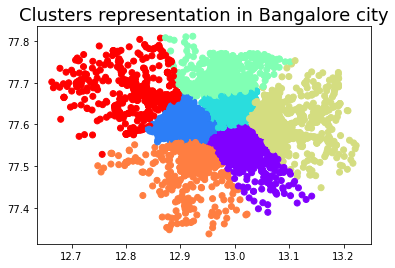

In [18]:
#have a quick look on clutering 
%matplotlib inline
data_with_clusters = B_cord.copy()
data_with_clusters['Clusters'] = identified_clusters 
labels = ["Cluster0","Cluster1","Cluster2","Cluster3","Cluster4","Cluster5","Cluster6"]
plt.scatter(data_with_clusters['lat'],data_with_clusters['long'],c=data_with_clusters['Clusters'],cmap='rainbow')
plt.title("Clusters representation in Bangalore city", size = 18)



### Visulizing these cluster in basemap

In [19]:
import folium
colors = ['red', 'blue', 'green', 'purple', 'orange', 'darkred', \
     'lightred', 'beige', 'darkblue', 'darkgreen', 'cadetblue', \
     'darkpurple', 'pink', 'lightblue', 'lightgreen', 'gray', \
     'black', 'lightgray', 'red', 'blue', 'green', 'purple', \
     'orange', 'darkred', 'lightred', 'beige', 'darkblue', \
     'darkgreen', 'cadetblue', 'darkpurple','pink', 'lightblue', \
     'lightgreen', 'gray', 'black', 'lightgray' ]
lat = B_cord.iloc[0]['lat']
lng = B_cord.iloc[0]['long']
map = folium.Map(location=[lat, lng], zoom_start=12)
for _, row in B_cord.iterrows():
    folium.CircleMarker(
        location=[row["lat"], row["long"]],
        radius=2, 
        weight=0.5, 
        fill=True, 
        fill_color=colors[int(row["cluster"])],
        color=colors[int(row["cluster"])]
    ).add_to(map)
item_txt = """<br> &nbsp; {item} &nbsp; <i class="fa fa-map-marker fa-2x" style="color:{col}"></i>"""
html_itms = item_txt.format( item= ["cluster" + str(i) for i in range(7)] , col= [colors[i] for i in range(7)])

legend_html = """
     <div style="
     position: fixed; 
     bottom: 50px; left: 50px; width: 200px; height: 160px; 
     border:2px solid grey; z-index:9999; 
     
     background-color:white;
     opacity: .85;
     
     font-size:14px;
     font-weight: bold;
     
     ">
     &nbsp; {title} 
     
     {itm_txt}

      </div> """.format( title = "Legend html", itm_txt= html_itms)
map.get_root().html.add_child(folium.Element( legend_html ))
map

The entire Banglore city is devided into seven potential region of intrest.

#### KMeans Algorithm for Mumbai city

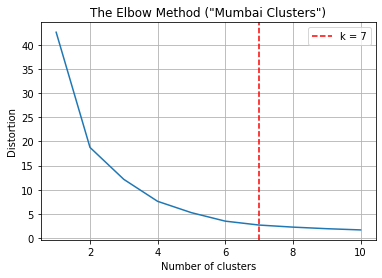

In [20]:
X = M_cord[['lat','long']]
max_k = 10
## iterations
distortions = [] 
for i in range(1, max_k+1):
    if len(X) >= i:
       model = KMeans(n_clusters=i, init='k-means++', max_iter=300, n_init=10, random_state=0)
       model.fit(X)
       distortions.append(model.inertia_)
## best k: the lowest derivative
k = [i*100 for i in np.diff(distortions,2)].index(min([i*100 for i 
     in np.diff(distortions,2)]))
## plot
fig, ax = plt.subplots()
ax.plot(range(1, len(distortions)+1), distortions)
ax.axvline(k, ls='--', color="red", label="k = "+str(k))
ax.set(title='The Elbow Method ("Mumbai Clusters")', xlabel='Number of clusters', 
       ylabel="Distortion")
ax.legend()
ax.grid(True)
plt.show()

#### Silhousett Score for Mumbai optimal clusters

In [21]:
#importing required library

from sklearn.metrics import silhouette_score

sil = []
kmax = 16

# dissimilarity would not be defined for a single cluster, thus, minimum number of clusters should be 2
for k in range(2, kmax+1):
  kmeans = KMeans(n_clusters = k).fit(M_cord)
  labels = kmeans.labels_
  sil.append(silhouette_score(M_cord, labels, metric = 'euclidean'))

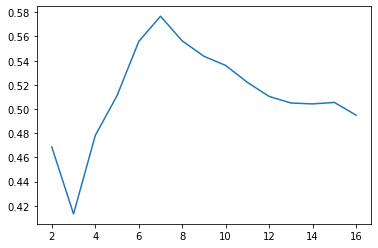

In [22]:
x = np.arange(2,kmax+1)
y = sil

plt.plot(x,y)

#### Peak observed at k = 7, so optimal cluster selection is 7.

In [23]:
kmeans = KMeans(7)
kmeans.fit(M_cord)
identified_clusters_mumbai = kmeans.fit_predict(M_cord)
M_cord['locality'] = identified_clusters_mumbai
mumbai['locality']= identified_clusters_mumbai
identified_clusters_mumbai

array([3, 3, 3, ..., 1, 3, 5])

In [24]:
mumbai['locality'] = list(identified_clusters_mumbai)

Text(0.5, 1.0, 'Clusters representation in mumbai city')

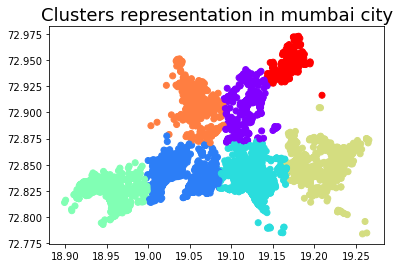

In [25]:
#have a quick look on clutering 
%matplotlib inline
data_with_clusters_mumbai_ = M_cord.copy()
data_with_clusters_mumbai_['Clusters'] = identified_clusters_mumbai 
labels = ["Cluster0","Cluster1","Cluster2","Cluster3","Cluster4","Cluster5","Cluster6"]
plt.scatter(data_with_clusters_mumbai_['lat'],data_with_clusters_mumbai_['long'],c=data_with_clusters_mumbai_['Clusters'],cmap='rainbow')
plt.title("Clusters representation in mumbai city", size = 18)

So there are again seven potential region of observation in Mumbai city as well.

#### Convention Note : In Bangalore, we will represents clusters as 'cluster', and in Mumbai we will represent clusters 'localities'

In [27]:
# droping all the rows where poi_type is null
bangalore.dropna(subset = ['poi_type'],inplace = True)

#### Deviding the bangalore data into seven differne cluster's DataFrame

* Bangalore

In [28]:
# Deviding the data into seven differne cluster's DataFrame 

cluster1 = bangalore[bangalore.cluster==1]
cluster2 = bangalore[bangalore.cluster==2]
cluster3 = bangalore[bangalore.cluster==3]
cluster4 = bangalore[bangalore.cluster==4]
cluster5 = bangalore[bangalore.cluster==5]
cluster6 = bangalore[bangalore.cluster==6]
cluster0 = bangalore[bangalore.cluster==0]

cluster0.head()


,source,poi_code,name,poi_type,lat,long,address,city,state,country,pin_code,brand,cluster
0,OSM,POI_1003_6612393918,Parle,shop.food.bakery,13.049754,77.492895,NaN,Bangalore,Karnataka,India,NaN,NaN,0
349,OSM,POI_1003_4320655389,Home,travel.accommodation.guest_house,13.036045,77.526822,NaN,Bangalore,Karnataka,India,NaN,NaN,0
362,OSM,POI_1003_3541202420,Satyanarayana Tools and Hardware,shop.home.hardware,13.036171,77.524798,NaN,Bangalore,Karnataka,India,NaN,NaN,0
364,OSM,POI_1003_3541202422,Shabari Motors,auto.motorcycle.dealership,13.035882,77.525290,NaN,Bangalore,Karnataka,India,NaN,NaN,0
365,OSM,POI_1003_3541202423,Sri Raghavendra Condiments and Chats,shop.supermarket.convenience,13.035869,77.525349,NaN,Bangalore,Karnataka,India,NaN,NaN,0


* Mumbai

In [29]:
locality0 = mumbai[mumbai.locality==0]
locality1 = mumbai[mumbai.locality==1]
locality2 = mumbai[mumbai.locality==2]
locality3 = mumbai[mumbai.locality==3]
locality4 = mumbai[mumbai.locality==4]
locality5 = mumbai[mumbai.locality==5]
locality6 = mumbai[mumbai.locality==6]

In [30]:
numbers_M = []
for i in range(7):
    numbers_M.append(  mumbai[mumbai.locality==i].shape[0])
    print("The shape of the locality",i,"in Mumbai is ",  mumbai[mumbai.locality==i].shape)

The shape of the locality 0 in Mumbai is  (783, 13)
The shape of the locality 1 in Mumbai is  (927, 13)
The shape of the locality 2 in Mumbai is  (1029, 13)
The shape of the locality 3 in Mumbai is  (861, 13)
The shape of the locality 4 in Mumbai is  (619, 13)
The shape of the locality 5 in Mumbai is  (543, 13)
The shape of the locality 6 in Mumbai is  (337, 13)


In [31]:
numbers = []
for i in range(7):
    numbers.append(  bangalore[bangalore.cluster==i].shape[0])
    print("The shape of the cluster",i,"in Bangalore is ",  bangalore[bangalore.cluster==i].shape)

The shape of the cluster 0 in Bangalore is  (3571, 13)
The shape of the cluster 1 in Bangalore is  (4341, 13)
The shape of the cluster 2 in Bangalore is  (4277, 13)
The shape of the cluster 3 in Bangalore is  (2355, 13)
The shape of the cluster 4 in Bangalore is  (1249, 13)
The shape of the cluster 5 in Bangalore is  (978, 13)
The shape of the cluster 6 in Bangalore is  (531, 13)


In [32]:

x = ["cluster" + str(i) for i in range(7)]
x_M = ["locality" + str(i) for i in range(7)]
numbers

[3571, 4341, 4277, 2355, 1249, 978, 531]

In [33]:
import warnings
warnings.filterwarnings("ignore")


### Comparision of each cluster/localities of bangalore city  

Note: Each cluter represents a part of bagalore city, and its own charateristis.

Text(0.5, 1.0, 'no of point of intrest in each cluster Bangalore')

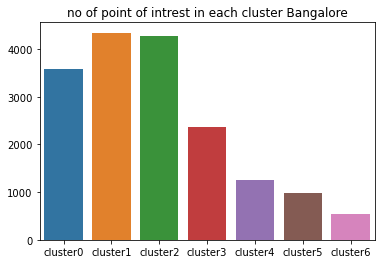

In [34]:
# no of point of intrest in each cluster
import seaborn as sns



sns.barplot(x,numbers)
plt.title("no of point of intrest in each cluster Bangalore")





Text(0.5, 1.0, 'no of point of intrest in each cluster Mumbai')

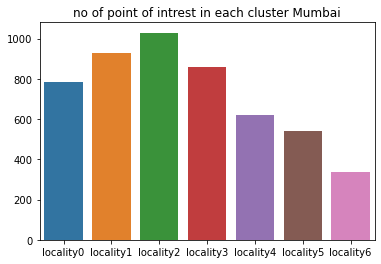

In [35]:

sns.barplot(x_M,numbers_M)
plt.title("no of point of intrest in each cluster Mumbai")

we can observe that the cluster0 and cluster1 and cluster6 have highest POI location in the city

In [36]:
# no of food facility in different clusters 

food  = []

for i in range(7):
    food.append(bangalore[bangalore.poi_type.str.contains("food")][bangalore['cluster']==i].shape[0])
    
food_M = []


for i in range(7):
    food_M.append(mumbai[mumbai.poi_type.str.contains("food")][mumbai['locality']==i].shape[0])



<Figure size 432x288 with 0 Axes>

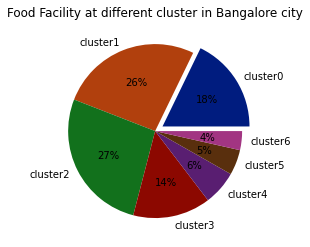

<Figure size 432x288 with 0 Axes>

In [37]:
%matplotlib inline
explode = [0.1, 0, 0, 0, 0,0,0]
# define Seaborn color palette to use
palette_color = sns.color_palette('dark')
plt.pie(food,labels = x,colors=palette_color,
        explode=explode, autopct='%.0f%%')
plt.title("Food Facility at different cluster in Bangalore city")
plt.figure()

<Figure size 432x288 with 0 Axes>

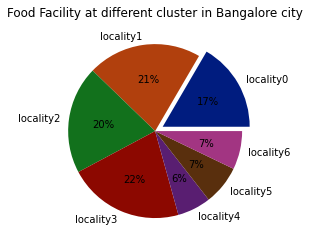

<Figure size 432x288 with 0 Axes>

In [38]:
%matplotlib inline
explode = [0.1, 0, 0, 0, 0,0,0]
# define Seaborn color palette to use
palette_color = sns.color_palette('dark')
plt.pie(food_M,labels = x_M,colors=palette_color,
        explode=explode, autopct='%.0f%%')
plt.title("Food Facility at different cluster in Bangalore city")
plt.figure()

#### Observation: locality 0,1,6 have higher food facility in mumbai, whereas in bangalore, cluster 0,1,2 have higer no of food facility.

#### Function to find the barplot of shop category in a given region/cluster

In [39]:
## HERE WE GO


## This is for Bangalore...
def shop_category(cluster,name):
    
    shops_type = []
    for i in range(cluster[cluster.poi_type.str.contains('shop')].poi_type.shape[0]):
        shops_type.append(cluster[cluster.poi_type.str.contains('shop')].poi_type.iloc[i].split('.')[1])
        
    shop_type = list(set(shops_type))
        
    counts = []
    for s in shop_type:
        counts.append(cluster[cluster.poi_type.str.contains('shop')][cluster['poi_type'].str.contains(str(s))].shape[0])
        
    
    %matplotlib inline
    plt.figure(figsize = (12,5))

    plt.xlabel("Different Types of Shops in" + name,size = 14)
    plt.ylabel("Number of shops of a given type", size = 14)
    plt.title("Shop Types in " + name,size = 18)
    sns.barplot(shop_type,counts)
    
## This is for Mumbai...
def shop_category_M(locality,name):
    
    shops_type_M = []
    for i in range(locality[locality.poi_type.str.contains('shop')].poi_type.shape[0]):
        shops_type_M.append(locality[locality.poi_type.str.contains('shop')].poi_type.iloc[i].split('.')[1])
        
    shop_type_M = list(set(shops_type_M))
        
    counts = []
    for s in shop_type_M:
        counts.append(locality[locality.poi_type.str.contains('shop')][locality['poi_type'].str.contains(str(s))].shape[0])
        
    
    %matplotlib inline
    plt.figure(figsize = (12,5))

    plt.xlabel("Different Types of Shops in" + name,size = 14)
    plt.ylabel("Number of shops of a given type", size = 14)
    plt.title("Shop Types in " + name,size = 18)
    sns.barplot(shop_type_M,counts)

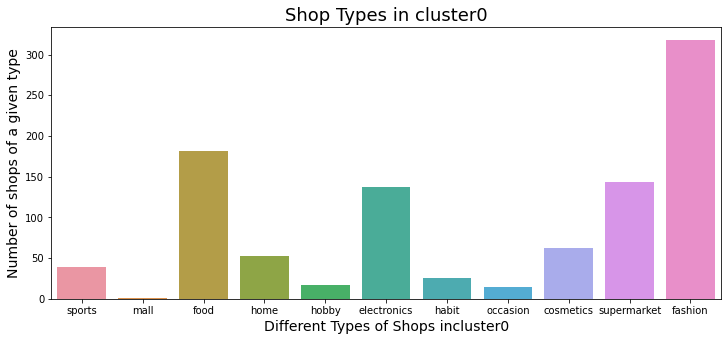

In [40]:
(shop_category(cluster0,"cluster0"))

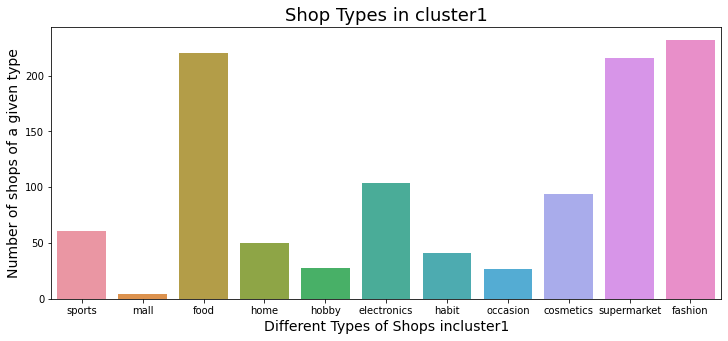

In [41]:
shop_category(cluster1,"cluster1")

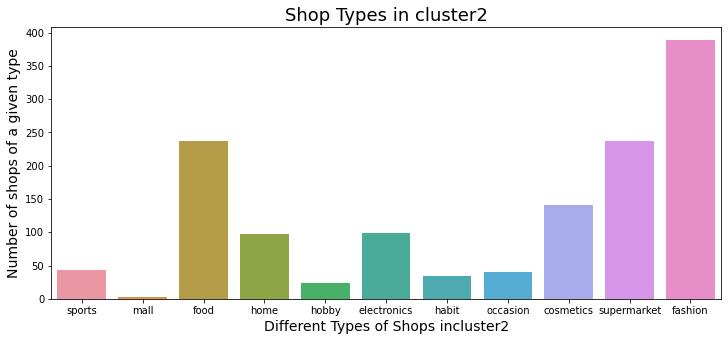

In [42]:
shop_category(cluster2,"cluster2")

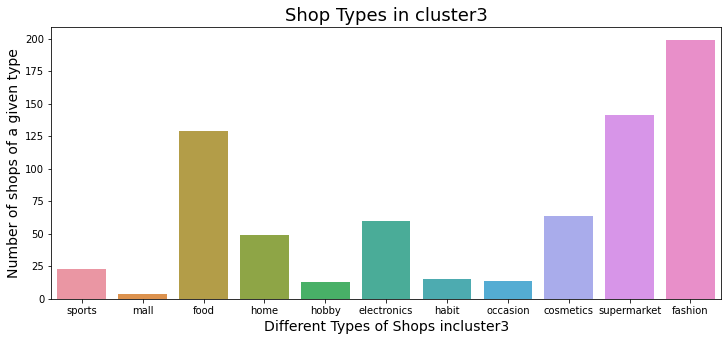

In [43]:
shop_category(cluster3,"cluster3")

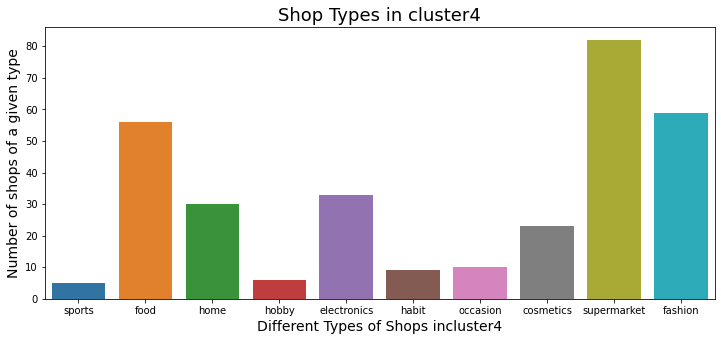

In [44]:
shop_category(cluster4,"cluster4")

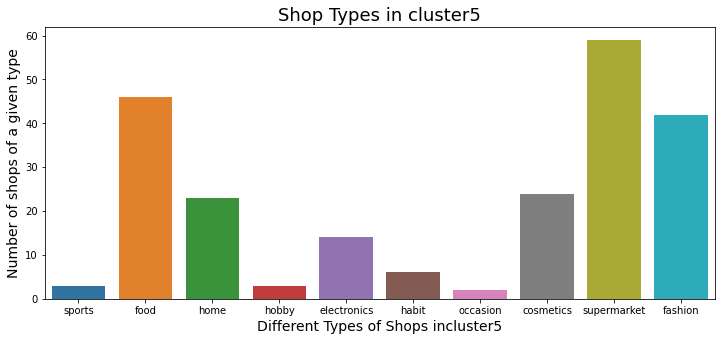

In [45]:
shop_category(cluster5,"cluster5")

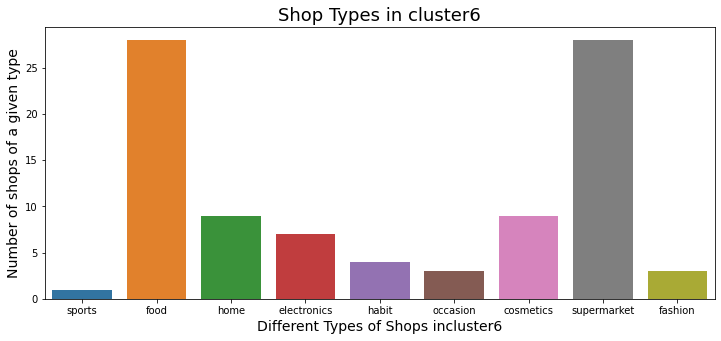

In [46]:
shop_category(cluster6,"cluster6")

Observations in Bangalore clusters:

1. Every region of Bangalore has fashion shop is in higher trends relatively. But area belongs to "cluster4" has very less number of shops in a category of fashion. So, if enterprenure wants to open a fashion shop, the area might be a better choice.

2. overall total no of shops and activities are higher in cluster0, cluster1, cluster2 and cluster6. As we can categorize these areas as developed area. Moreover,  only this cluster of areas contains malls. 

3. Food shops are very common in all areas.

#### Mumbai's shop analysis

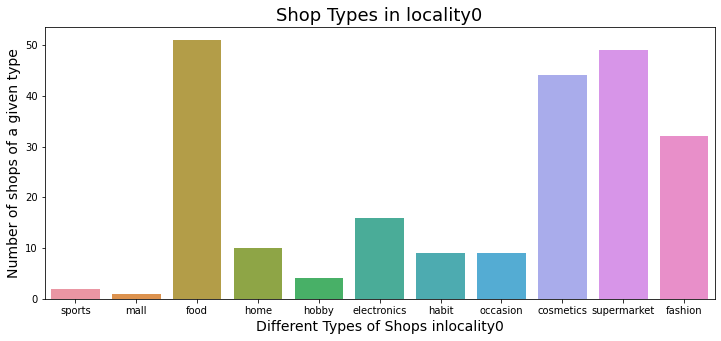

In [47]:
shop_category_M(locality0,"locality0")


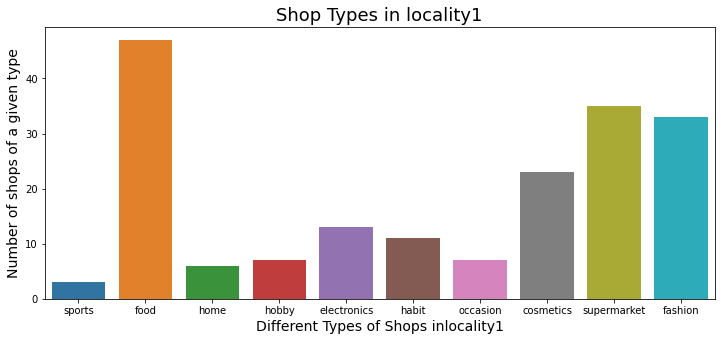

In [48]:
shop_category_M(locality1,"locality1")

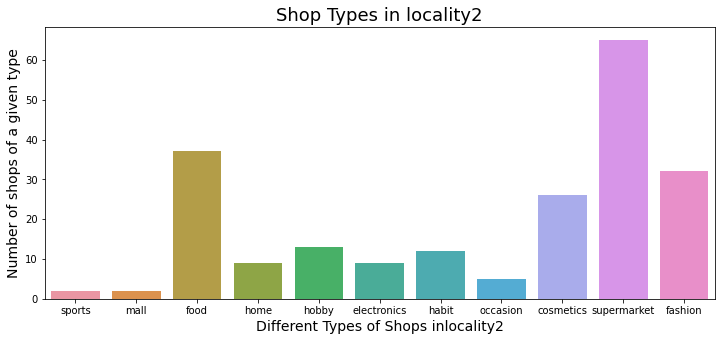

In [49]:
shop_category_M(locality2,"locality2")

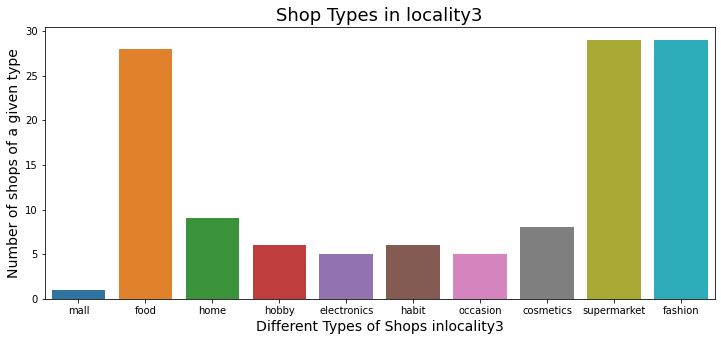

In [50]:
shop_category_M(locality3,"locality3")

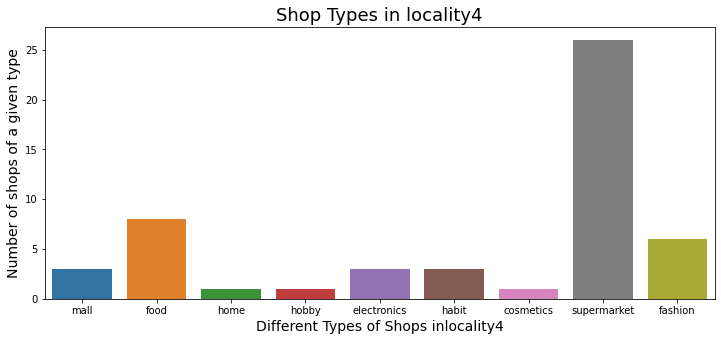

In [51]:
shop_category_M(locality4,"locality4")

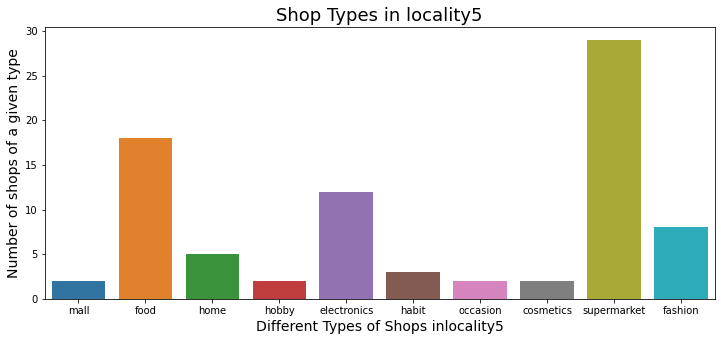

In [52]:
shop_category_M(locality5,"locality5")

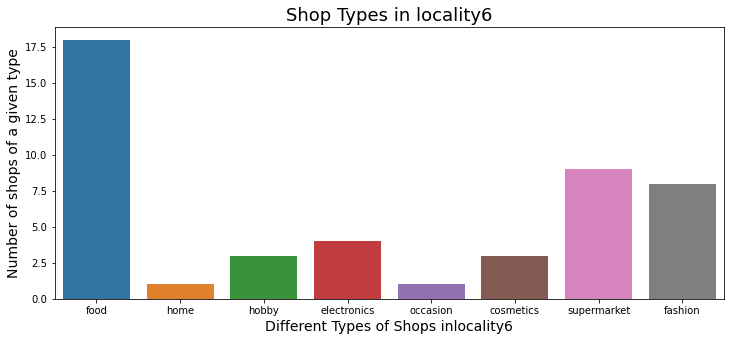

In [53]:
shop_category_M(locality6,"locality6")

#### Observations: 

1. In Mumbai, supermarkets and food shops are very common in every area.
2. in locality6, cosmetics shops are more 

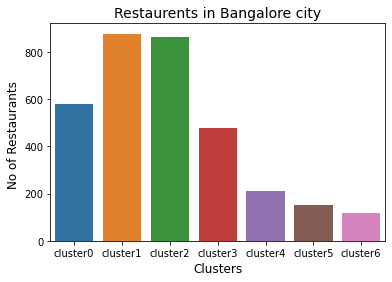

In [66]:
res = []
for i in range(7):
    res.append(bangalore[bangalore['poi_type'].str.contains("restaurant")][bangalore.cluster==i].shape[0])
sns.barplot(x,res)
plt.xlabel("Clusters",size = 12)
plt.ylabel("No of Restaurants ",size = 12)
plt.title("Restaurents in Bangalore city",size = 14)
plt.show()
        
    

we can see that area belonging to cluster1 and cluster2 have highest restaurent trends in a bangalore city.

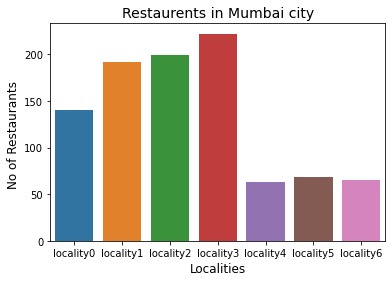

In [68]:
res_M = []
for i in range(7):
    res_M.append(mumbai[mumbai['poi_type'].str.contains("restaurant")][mumbai.locality==i].shape[0])
sns.barplot(x_M,res_M)
plt.xlabel("Localities",size = 12)
plt.ylabel("No of Restaurants ",size = 12)
plt.title("Restaurents in Mumbai city",size = 14)
plt.show()

in a mumbai city, locality 3 has highest no of Restaurent. 